# Spectrogram Plotting with plotly

Requirements:   
- plotly   
- spchutils   

In [1]:
import os,sys 
import numpy as np
import pandas as pd
from IPython.display import display, Audio, HTML
import soundfile as sf

import plotly 
import plotly.graph_objects as go
from plotly.subplots import make_subplots
print(plotly.__version__)

#
import spchutils.spectrogram as specg
import spchutils.audio as audio
import spchutils.utils as spch

4.12.0


In [2]:
# set basename and directories
dir='https://raw.githubusercontent.com/compi1234/spchlab/master/data/'
file = "timit/si1027" #@param {type:"string"}
basename = dir+file
wavfname = basename + ".wav"
wrdfname = basename + ".wrd"
phnfname = basename + ".phn"

# 1. read the waveform data
wavdata, sr = audio.load(wavfname)
nsamples = len(wavdata)
etime = float(nsamples)/float(sr)
wavtime = np.arange(0, nsamples)/float(sr)
wavrange = 1.2*np.max(np.abs(wavdata))

# 2. compute spectrogram
fshift = 0.01
spgdata = specg.spectrogram(wavdata,sample_rate=sr,frame_shift=fshift*1000.,n_mels=None)
(nparam,nfr) = spgdata.shape
spg_xaxis = (np.arange(nfr)+0.5)*fshift
spg_yaxis = np.arange(nparam)*sr/(2.*(nparam-1))

# 3. get segmentations
segwrd = pd.read_csv(wrdfname,delim_whitespace=True,names=['t0','t1','seg'])
segphn = pd.read_csv(phnfname,delim_whitespace=True,names=['t0','t1','seg'])
# convert sample based segmentations to time based segmentations
segphn['t0']=spch.indx2t(segphn['t0'],1./sr)
segphn['t1']=spch.indx2t(segphn['t1'],1./sr)
segwrd['t0']=spch.indx2t(segwrd['t0'],1./sr)
segwrd['t1']=spch.indx2t(segwrd['t1'],1./sr)

In [3]:
help(specg.spectrogram)

Help on function spectrogram in module spchutils.spectrogram:

spectrogram(y, sample_rate=16000, frame_shift=10.0, frame_length=30.0, preemp=0.97, n_fft=512, window='hamm', output='dB', n_mels=None)
    spectrogram is a wrapper making use of the librosa() stft library 
    + with arguments for frame_shift and frame_length in msec 
    + and with  some adjustments on frame positioning similar to Kaldi / SPRAAK
        - (a) frame positioning : centered at: k*n_shift + n_shift/2
        - (b) #frames:  n_samples // n_shift (first and last frame partially filled with mirrored data)
        - (c) edge processing: mirroring of input signal around the edges
        - (d) pre-emphasis is applied after edge processing  (librosa does it before)
    
    required arguments:
      y       waveform data (numpy array) 
    
    optional arguments:
      sample_rate  sample rate in Hz, default=16000
      frame_shift  frame shift in msecs, default= 10.0 msecs
      frame_length frame length in msecs

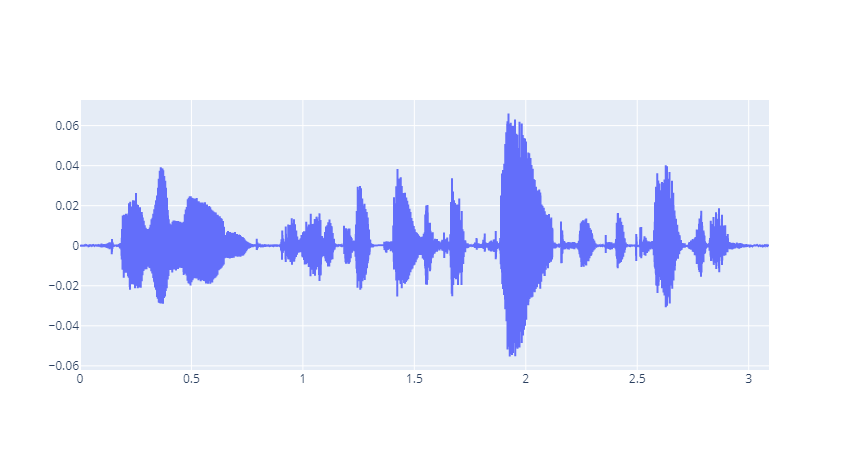

In [4]:
wave_go = go.Scatter(y=wavdata, dx=1./sr,
                  showlegend=False,
                  hoverinfo="x+y",
                 )
go.Figure(wave_go).show()

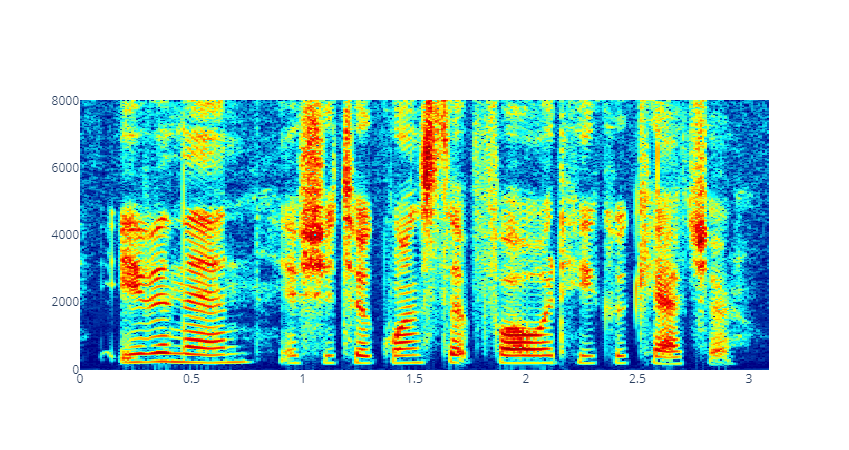

In [5]:
spg_go = go.Heatmap(z=spgdata,dx=fshift,x0=fshift/2.,dy=sr/(2*(nparam-1)),
                 colorscale='Jet',
                 showscale=False,
                 showlegend=False,
                 hoverinfo="x+y+z",
                 name='Spectrogram',
                 text=spgdata)
go.Figure(spg_go).show()

In [6]:
# makes a graphics object (Scatter) of a text transcription
# segmentation is given as a dataframe with columns [t0,t1,seg]  (t0,t1 expressed in secs)
# frameshift is a multiplication factor that can be applied to convert frame numbers to 
#   secs, typically then 0.01 
def go_seg_txt(segdf,frameshift=1.0,textfont={'color':'black','size':14},yval=0.5):
    nseg = len(segdf)
    btime = np.array(segdf.t0)*frameshift
    etime = np.array(segdf.t1)*frameshift
    xpos = 0.5*(btime + etime)
    ypos = yval*np.ones(nseg)
    segtxt = go.Scatter(x=xpos,y=ypos,text=segdf.seg,mode='text',
                  textfont=textfont,
                  hoverinfo="x+text",
                  showlegend=False)
    return segtxt

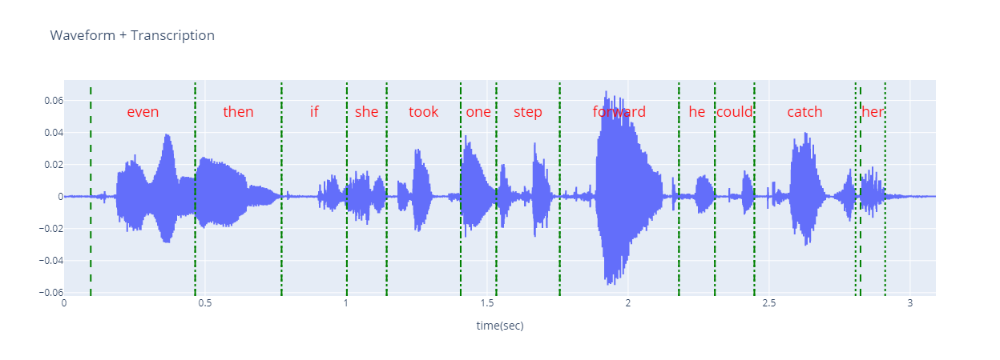

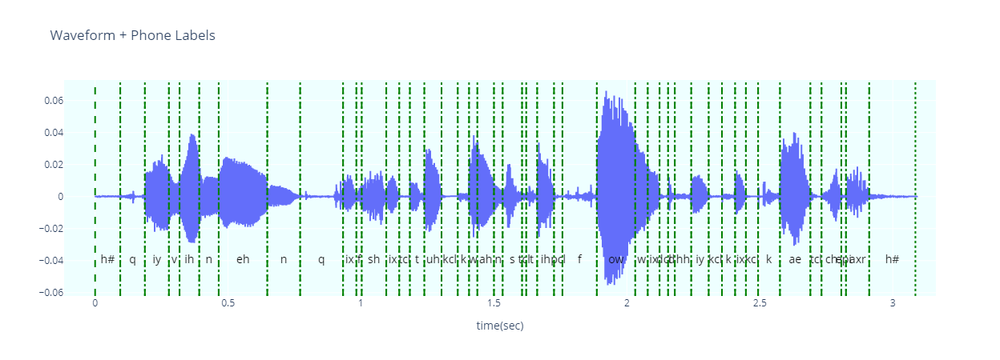

In [22]:
segwrd_go1 = go_seg_txt(segwrd,frameshift=1.,textfont={'color':'red','size':18},yval=0.66*wavrange)
layout1 = dict(title="Waveform + Transcription",
             xaxis=dict(title="Time(sec)",zeroline=False),
             yaxis=dict(zeroline=False,fixedrange=True))

fig = go.Figure(data=[wave_go, segwrd_go1],layout=layout1)
for iseg in range(0,len(segwrd)):
    fig.add_vline(x=segwrd['t0'][iseg], line_dash='dash',line_color='green')
    fig.add_vline(x=segwrd['t1'][iseg], line_dash='dot',line_color='green')
fig.show()

segphn_go1 = go_seg_txt(segphn,textfont={'color':'black','size':14},yval=-0.5*wavrange)
layout2 = dict(title="Waveform + Phone Labels",plot_bgcolor="#eff",
             xaxis=dict(title="Time(sec)",zeroline=False),
             yaxis=dict(zeroline=False,fixedrange=True))
fig2 = go.Figure(data=[wave_go, segphn_go1],layout=layout2)
for iseg in range(0,len(segphn)):
    fig2.add_vline(x=segphn['t0'][iseg], line_dash='dash',line_color='green')
    fig2.add_vline(x=segphn['t1'][iseg], line_dash='dot',line_color='green')
fig2.show()
#display(Audio(data=wavdata,rate=16000))

## SPECTROGRAM PLOT in plotly
    - using subplots to allow for waveform / spectrogram / segmentations ..

1. Generate the subplot framework
    - make a cellgrid with a specified number of (rows,cols)   
    - You can span single subplots over a range of cells   
2. Add traces   
    - refer to cells in the grid (counting starts at 1 !!!!)
    - when using a plot over mulitple cells, give position (TOP,LEFT) 
    - For adding layout features: refer to the number of the plot ..   

Known Limitations:
- Rangeslider: 
    + selects automatically the trace of the first subplot to show in range slider (in plotly.js this is possible via showtraces, not in python) and shows it immediately below, which actually enforces one to use start_cell = bottom-left 
    + no event listener to get the rangeslider boundaries. e.g. for selective audio play
- subplots: many layout features, such as background color, can not be controlled at the subplot level
- interactivity: 

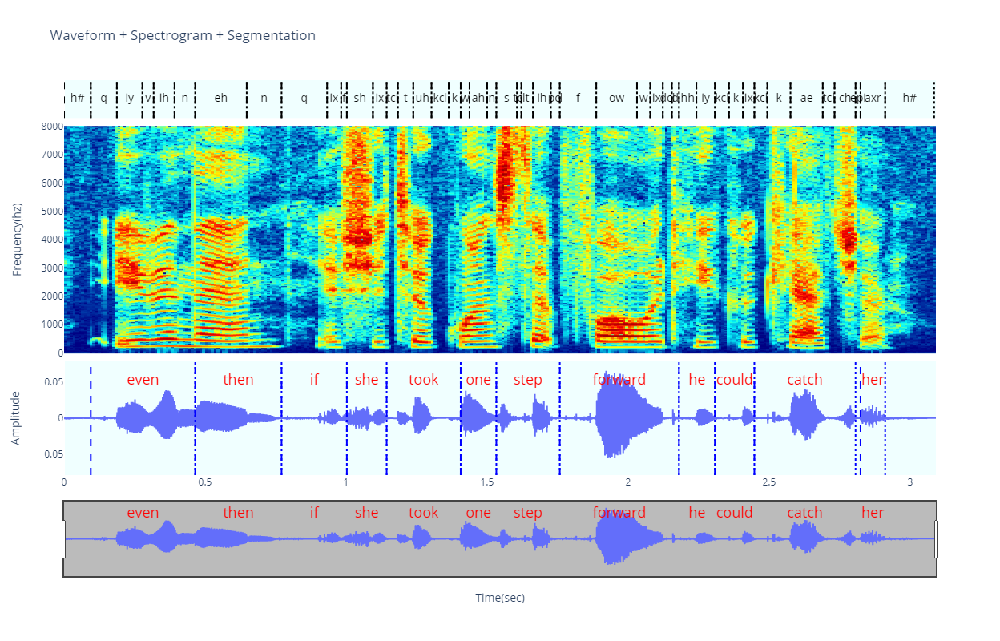

In [31]:
fig = make_subplots(rows=3, cols=1, row_heights=[.3,.6,.1],
                   shared_xaxes=True,
                   vertical_spacing=0.02,
                   start_cell='bottom-left')
fig.update_xaxes(showgrid=False,range=[wavtime[0],wavtime[nsamples-1]])
fig.update_yaxes(showgrid=False,fixedrange=True,zeroline=False)


fig.add_trace(wave_go,1,1)
fig.add_trace(segwrd_go1,1,1)
fig.update_yaxes(row=1,title_text='Amplitude',range=[-wavrange,wavrange],zeroline=True)
for iseg in range(0,len(segwrd)):
    fig.add_vline(row=1,x=segwrd['t0'][iseg], line_dash='dash',line_color='blue')
    fig.add_vline(row=1,x=segwrd['t1'][iseg], line_dash='dot',line_color='blue')
    
fig.add_trace(spg_go,2,1)
fig.update_yaxes(row=2,title_text='Frequency(hz)')

fig.add_trace(segphn_go1,3,1)
fig.update_yaxes(row=3,showticklabels=False)
for iseg in range(0,len(segphn)):
    fig.add_vline(row=3,x=segphn['t0'][iseg], line_dash='dash',line_color='black')
    fig.add_vline(row=3,x=segphn['t1'][iseg], line_dash='dot',line_color='black')
    
fig.update_layout(height=800,width=1000,title_text="Waveform + Spectrogram + Segmentation",selectdirection="h",plot_bgcolor="#f0ffff")
#fig['layout'].update(selectdirection="h",plot_bgcolor="#f0ffff")
fig['layout']['yaxis'].update(fixedrange=True,type='linear')
fig['layout']['xaxis'].update(title='Time(sec)',
                               type='linear',
                               rangeslider=dict(visible=True,borderwidth=2,bgcolor="#bbb",range=[wavtime[0],wavtime[nsamples-1]]), 
                               showgrid=False)
fig.show()
display(Audio(data=wavdata,rate=sr))

